In [1]:
import os
import folium
import random
import collections
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from shapely.geometry import Polygon, Point
from geopy.distance import geodesic

In [2]:
bikes = pd.read_csv('../cleaned_data/bikes_data.csv')
fences = pd.read_csv('../cleaned_data/fence_position.csv')

In [3]:
bikes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 339810 entries, 0 to 339809
Data columns (total 11 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   DAY            339810 non-null  int64  
 1   BID            339810 non-null  int64  
 2   BICYCLE_ID     339810 non-null  object 
 3   LATITUDE       339810 non-null  float64
 4   LONGITUDE      339810 non-null  float64
 5   LOCK_STATUS    339810 non-null  int64  
 6   UPDATE_TIME    339810 non-null  object 
 7   GRID           339810 non-null  object 
 8   NEAREST_FENCE  339810 non-null  int64  
 9   DISTANCE       339810 non-null  float64
 10  MKTIME         339810 non-null  int64  
dtypes: float64(3), int64(5), object(3)
memory usage: 28.5+ MB


In [4]:
fences.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14071 entries, 0 to 14070
Data columns (total 18 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   FENCE_ID     14071 non-null  object 
 1   LATITUDE_0   14071 non-null  float64
 2   LONGITUDE_0  14071 non-null  float64
 3   LATITUDE_1   14071 non-null  float64
 4   LONGITUDE_1  14071 non-null  float64
 5   LATITUDE_2   14071 non-null  float64
 6   LONGITUDE_2  14071 non-null  float64
 7   LATITUDE_3   14071 non-null  float64
 8   LONGITUDE_3  14071 non-null  float64
 9   LATITUDE_4   14071 non-null  float64
 10  LONGITUDE_4  14071 non-null  float64
 11  LATITUDE     14071 non-null  float64
 12  LONGITUDE    14071 non-null  float64
 13  ROAD         14071 non-null  object 
 14  AREA         14071 non-null  float64
 15  FID          14071 non-null  int64  
 16  LENGTH       14071 non-null  float64
 17  WIDTH        14071 non-null  float64
dtypes: float64(15), int64(1), object(2)
memory usa

In [5]:
fences.rename(columns={'LATITUDE': 'F_LATITUDE', 'LONGITUDE': 'F_LONGITUDE'}, inplace = True)
bikes = pd.merge(bikes, fences, left_on = 'NEAREST_FENCE', right_on = 'FID', how = 'left')
bikes.fillna(-1, inplace = True)

In [6]:
def center_distance(f_latitude, f_longitude, latitude, longitude):
    if -1 in (f_latitude, f_longitude, latitude, longitude):
        return -1
    p1 = (f_latitude, f_longitude)
    p2 = (latitude, longitude)
    return geodesic(p1, p2).meters

bikes['CENTER_DISTANCE'] = bikes.apply(lambda x: center_distance(x['F_LATITUDE'], x['F_LONGITUDE'], x['LATITUDE'], x['LONGITUDE']), axis = 1)


In [7]:
bikes_valid = bikes[((bikes['CENTER_DISTANCE'] <= 50) & (bikes['DISTANCE'] != -1)) | (bikes['DISTANCE'] <=30) & (bikes['DISTANCE'] != -1)]
bikes_outliers = bikes[~bikes['BID'].isin(bikes_valid['BID'])]

In [8]:
bikes_valid.info()
print('----------------------------------')
bikes_outliers.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 294416 entries, 4894 to 339808
Data columns (total 30 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   DAY              294416 non-null  int64  
 1   BID              294416 non-null  int64  
 2   BICYCLE_ID       294416 non-null  object 
 3   LATITUDE         294416 non-null  float64
 4   LONGITUDE        294416 non-null  float64
 5   LOCK_STATUS      294416 non-null  int64  
 6   UPDATE_TIME      294416 non-null  object 
 7   GRID             294416 non-null  object 
 8   NEAREST_FENCE    294416 non-null  int64  
 9   DISTANCE         294416 non-null  float64
 10  MKTIME           294416 non-null  int64  
 11  FENCE_ID         294416 non-null  object 
 12  LATITUDE_0       294416 non-null  float64
 13  LONGITUDE_0      294416 non-null  float64
 14  LATITUDE_1       294416 non-null  float64
 15  LONGITUDE_1      294416 non-null  float64
 16  LATITUDE_2       294416 non-null  f

In [9]:
bikes.describe()

,DAY,BID,LATITUDE,LONGITUDE,LOCK_STATUS,NEAREST_FENCE,DISTANCE,MKTIME,LATITUDE_0,LONGITUDE_0,...,LONGITUDE_3,LATITUDE_4,LONGITUDE_4,F_LATITUDE,F_LONGITUDE,AREA,FID,LENGTH,WIDTH,CENTER_DISTANCE
count,339810.000000,339810.000000,339810.000000,339810.000000,339810.000000,339810.000000,339810.000000,3.398100e+05,339810.000000,339810.000000,...,339810.000000,339810.000000,339810.000000,339810.000000,339810.000000,339810.000000,339810.000000,339810.000000,339810.000000,339810.000000
mean,22.956935,278480.495041,24.496130,118.126505,0.489329,6839.091948,22.835778,1.608678e+09,24.128743,116.410851,...,116.410845,24.128743,116.410851,24.128742,116.410843,13.061453,6839.091948,7.742053,1.642289,25.327080
std,1.502877,187040.484523,0.023844,0.030728,0.499887,4127.508885,35.733226,1.298693e+05,3.037725,14.192991,...,14.192990,3.037725,14.192991,3.037725,14.192990,10.392428,4127.508885,5.448078,0.434609,35.765065
min,21.000000,1523.000000,24.426163,118.058908,0.000000,-1.000000,-1.000000,1.608505e+09,-1.000000,-1.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,22.000000,105013.250000,24.478494,118.102207,0.000000,3563.000000,4.809651,1.608593e+09,24.477665,118.101062,...,118.101057,24.477665,118.101062,24.477647,118.101051,8.051673,3563.000000,4.799221,1.526485,7.380733
50%,23.000000,240053.500000,24.492356,118.123054,0.000000,6490.000000,11.487508,1.608681e+09,24.491629,118.122618,...,118.122614,24.491629,118.122618,24.491624,118.122622,10.596763,6490.000000,6.417857,1.659359,14.171940
75%,24.000000,461623.750000,24.515151,118.150420,1.000000,10596.000000,23.613464,1.608771e+09,24.514293,118.150035,...,118.150032,24.514293,118.150035,24.514299,118.150005,14.950334,10596.000000,8.915401,1.769774,26.326296
max,25.000000,585201.000000,24.559082,118.195910,1.000000,14070.000000,384.893016,1.608858e+09,24.558003,118.192612,...,118.192610,24.558003,118.192612,24.558003,118.192591,213.766104,14070.000000,84.424621,9.661157,388.003152


In [10]:
in_12_21 = bikes_valid[(bikes_valid['DAY'] == 21) & (bikes_valid['LOCK_STATUS'] == 1)]
out_12_21 = bikes_valid[(bikes_valid['DAY'] == 21) & (bikes_valid['LOCK_STATUS'] == 0)]
in_12_22 = bikes_valid[(bikes_valid['DAY'] == 22) & (bikes_valid['LOCK_STATUS'] == 1)]
out_12_22 = bikes_valid[(bikes_valid['DAY'] == 22) & (bikes_valid['LOCK_STATUS'] == 0)]
in_12_23 = bikes_valid[(bikes_valid['DAY'] == 23) & (bikes_valid['LOCK_STATUS'] == 1)]
out_12_23 = bikes_valid[(bikes_valid['DAY'] == 23) & (bikes_valid['LOCK_STATUS'] == 0)]
in_12_24 = bikes_valid[(bikes_valid['DAY'] == 24) & (bikes_valid['LOCK_STATUS'] == 1)]
out_12_24 = bikes_valid[(bikes_valid['DAY'] == 24) & (bikes_valid['LOCK_STATUS'] == 0)]
in_12_25 = bikes_valid[(bikes_valid['DAY'] == 25) & (bikes_valid['LOCK_STATUS'] == 1)]
out_12_25 = bikes_valid[(bikes_valid['DAY'] == 25) & (bikes_valid['LOCK_STATUS'] == 0)]
ins = [in_12_21, in_12_22, in_12_23, in_12_24, in_12_25]
outs = [out_12_21, out_12_22, out_12_23, out_12_24, out_12_25]

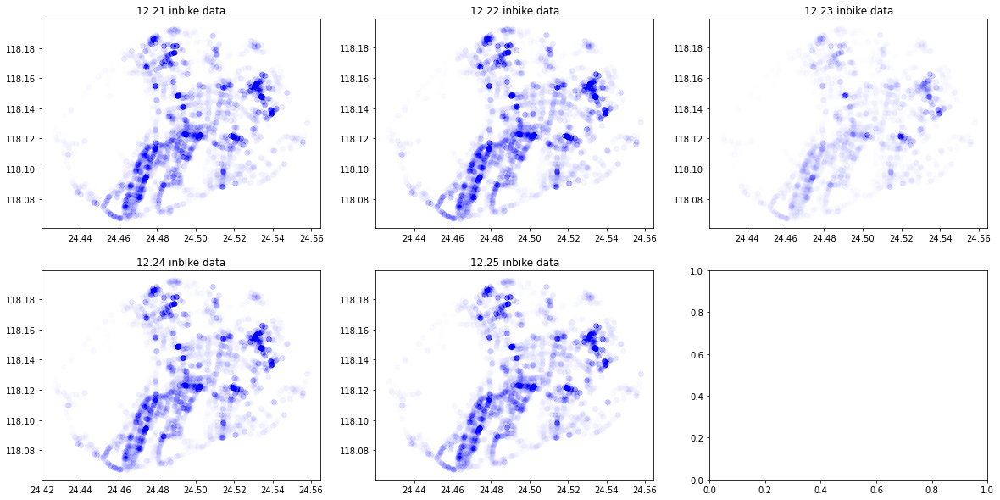

In [11]:
f, ax = plt.subplots(2, 3, figsize = (20, 10), squeeze=False)
names = [21, 22, 23, 24, 25]
for i in range(5):
    cur_dataset = ins[i]
    currow = i//3
    curcol = i%3
    ax[currow][curcol].set_title('12.' + str(names[i]) + ' inbike data')
    ax[currow][curcol].scatter(data = cur_dataset, x = 'LATITUDE', y = 'LONGITUDE', alpha = 0.005, color = 'blue')

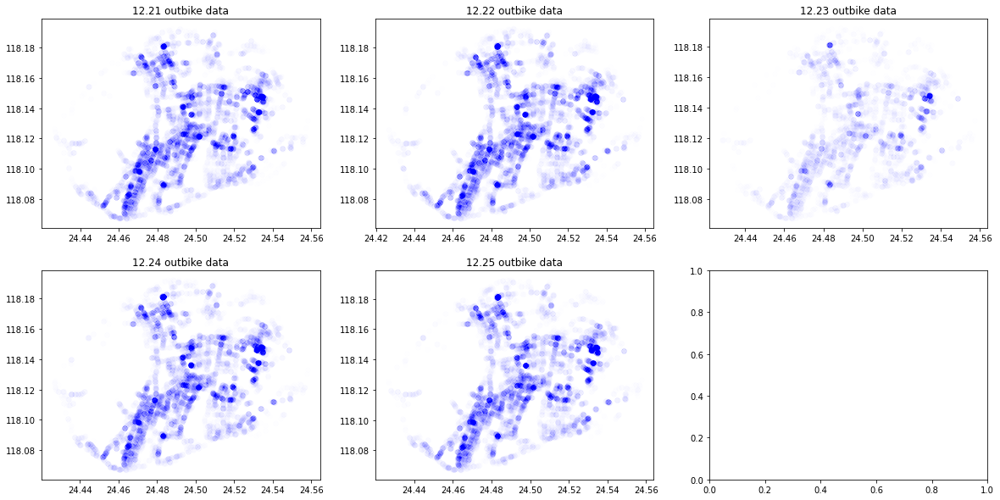

In [12]:
f, ax = plt.subplots(2, 3, figsize = (20, 10), squeeze=False)
for i in range(5):
    cur_dataset = outs[i]
    currow = i//3
    curcol = i%3
    ax[currow][curcol].set_title('12.' + str(names[i]) + ' outbike data')
    ax[currow][curcol].scatter(data = cur_dataset, x = 'LATITUDE', y = 'LONGITUDE', alpha = 0.005, color = 'blue')

In [13]:
in_out_info = bikes_valid.groupby(['DAY', 'LOCK_STATUS', 'NEAREST_FENCE']).count()

In [14]:
days = [21, 22, 23, 24, 25]
for d in days:
    curday_data = in_out_info.loc[d]
    lock_status = [0, 1]
    for status in lock_status:
        kname = str(d) + '_' + str(status)
        bucket = len(fences) * [0]
        fence_data = curday_data.loc[status]
        for fid in fence_data.index:
            bucket[fid] = fence_data.loc[fid]['BID']
        fences[kname] = bucket

In [15]:
fences['21_FLOW'] = fences.apply(lambda x: (x['21_1'] - x['21_0']), axis = 1)
fences['22_FLOW'] = fences.apply(lambda x: (x['22_1'] - x['22_0']), axis = 1)
fences['23_FLOW'] = fences.apply(lambda x: (x['23_1'] - x['23_0']), axis = 1)
fences['24_FLOW'] = fences.apply(lambda x: (x['24_1'] - x['24_0']), axis = 1)
fences['25_FLOW'] = fences.apply(lambda x: (x['25_1'] - x['25_0']), axis = 1)

In [16]:
fences['FLOW'] = fences.apply(lambda x: (x['21_FLOW'] + x['22_FLOW'] + x['23_FLOW'] +x['24_FLOW'] + x['25_FLOW']), axis = 1)
fences['FLOW_DENSITY'] = fences.apply(lambda x: (x['FLOW'] / x['AREA']), axis = 1)

In [17]:
fences.describe()

,LATITUDE_0,LONGITUDE_0,LATITUDE_1,LONGITUDE_1,LATITUDE_2,LONGITUDE_2,LATITUDE_3,LONGITUDE_3,LATITUDE_4,LONGITUDE_4,...,24_1,25_0,25_1,21_FLOW,22_FLOW,23_FLOW,24_FLOW,25_FLOW,FLOW,FLOW_DENSITY
count,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000,...,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000,14071.000000
mean,24.497457,118.124127,24.497449,118.124117,24.497457,118.124111,24.497464,118.124121,24.497457,118.124127,...,2.348021,2.243124,2.350224,0.146969,0.149527,0.071281,0.108166,0.107100,0.583043,0.028934
std,0.024843,0.030809,0.024842,0.030809,0.024844,0.030808,0.024845,0.030808,0.024843,0.030809,...,5.232238,5.820114,5.136945,6.218367,6.800212,2.839731,6.298810,6.108412,26.780039,2.570986
min,24.426603,118.066970,24.426566,118.067023,24.426572,118.067036,24.426609,118.066983,24.426603,118.066970,...,0.000000,0.000000,0.000000,-145.000000,-157.000000,-65.000000,-189.000000,-163.000000,-677.000000,-72.614801
25%,24.478666,118.097642,24.478639,118.097646,24.478651,118.097623,24.478678,118.097635,24.478666,118.097642,...,0.000000,0.000000,0.000000,-1.000000,-1.000000,0.000000,-1.000000,-1.000000,-2.000000,-0.167570
50%,24.496745,118.120755,24.496712,118.120736,24.496732,118.120735,24.496763,118.120757,24.496745,118.120755,...,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.044789
75%,24.515778,118.149915,24.515771,118.149891,24.515782,118.149892,24.515798,118.149904,24.515778,118.149915,...,3.000000,2.000000,3.000000,1.000000,1.000000,1.000000,1.000000,1.000000,4.000000,0.408829
max,24.558003,118.192612,24.557989,118.192572,24.558004,118.192570,24.558018,118.192610,24.558003,118.192612,...,135.000000,179.000000,135.000000,127.000000,145.000000,49.000000,128.000000,128.000000,568.000000,48.175408


In [18]:
x = list(zip(fences['F_LATITUDE'].tolist(), fences['F_LONGITUDE'].tolist()))

In [19]:
cluster = DBSCAN(eps = 0.00025, min_samples = 1).fit_predict(x)

In [20]:
cluster_counter = collections.Counter(cluster)
print("{} fences in {} clusters".format(len(fences), len(cluster_counter)))
max_index = max(cluster_counter, key=lambda x: cluster_counter[x])
print("Cluster {} has maximun number of fences, with fence number {}".format(max_index, max(cluster_counter.values())))

14071 fences in 4940 clusters
Cluster 2641 has maximun number of fences, with fence number 68


In [21]:
fences['CLUSTER'] = cluster

In [22]:
fences.head()

,FENCE_ID,LATITUDE_0,LONGITUDE_0,LATITUDE_1,LONGITUDE_1,LATITUDE_2,LONGITUDE_2,LATITUDE_3,LONGITUDE_3,LATITUDE_4,...,25_0,25_1,21_FLOW,22_FLOW,23_FLOW,24_FLOW,25_FLOW,FLOW,FLOW_DENSITY,CLUSTER
0,长乐路0_L_A17001,24.527338,118.103198,24.527373,118.103224,24.527366,118.103236,24.527331,118.103209,24.527338,...,0,0,0,0,0,0,0,0,0.000000,0
1,长乐路0_L_A17002,24.527303,118.103171,24.527338,118.103198,24.527331,118.103209,24.527296,118.103182,24.527303,...,0,0,-1,0,0,-2,0,-3,-0.465632,0
2,长乐路0_L_A17003,24.527386,118.103231,24.527421,118.103257,24.527413,118.103270,24.527378,118.103244,24.527386,...,0,0,0,0,0,0,0,0,0.000000,0
3,长乐路0_L_A17004,24.527421,118.103257,24.527455,118.103282,24.527447,118.103295,24.527413,118.103270,24.527421,...,1,1,-1,-2,-1,0,0,-4,-0.555097,0
4,长乐路0_L_A17005,24.527003,118.102948,24.527046,118.102979,24.527038,118.102992,24.526995,118.102961,24.527003,...,2,0,-1,-2,0,-1,-2,-6,-0.662373,0


In [23]:
cluster_area = fences.groupby('CLUSTER').agg({'AREA':'sum'})
cluster_cnt = fences.groupby('CLUSTER').agg({'FID':'count'})
cluster_21_flow = fences.groupby('CLUSTER').agg({'21_FLOW':'sum'})
cluster_22_flow = fences.groupby('CLUSTER').agg({'22_FLOW':'sum'})
cluster_23_flow = fences.groupby('CLUSTER').agg({'23_FLOW':'sum'})
cluster_24_flow = fences.groupby('CLUSTER').agg({'24_FLOW':'sum'})
cluster_25_flow = fences.groupby('CLUSTER').agg({'25_FLOW':'sum'})


In [24]:
cluster_detail = pd.merge(cluster_cnt, cluster_area, how = 'left', left_index = True, right_index = True)
for i in range(21, 26):
    cluster_detail = pd.merge(cluster_detail, eval('cluster_' + str(i) + '_flow'), how = 'left', left_index = True, right_index = True)

In [25]:
def peek_day(a, b, c, d, e):
    cnt = 0
    for day in [a, b, c, d, e]:
        if day > 0:
            cnt += 1
    return cnt

In [26]:
cluster_detail['FLOW'] = cluster_detail.apply(lambda x: x['21_FLOW'] + x['22_FLOW'] + x['23_FLOW'] + x['24_FLOW'] + x['25_FLOW'], axis = 1)
cluster_detail['ACTIVE_DAYS'] = cluster_detail.apply(lambda x: peek_day(x['21_FLOW'], x['22_FLOW'], x['23_FLOW'], x['24_FLOW'], x['25_FLOW']), axis = 1)
cluster_detail['FLOW_DENSITY'] = cluster_detail.apply(lambda x: x['FLOW']/x['AREA'], axis = 1)

In [27]:
cluster_detail.describe()

,FID,AREA,21_FLOW,22_FLOW,23_FLOW,24_FLOW,25_FLOW,FLOW,ACTIVE_DAYS,FLOW_DENSITY
count,4940.000000,4940.000000,4940.000000,4940.000000,4940.000000,4940.000000,4940.000000,4940.000000,4940.000000,4940.000000
mean,2.848381,34.274094,0.418623,0.425911,0.203036,0.308097,0.305061,1.660729,2.113765,-0.000917
std,3.821049,45.247883,13.130278,14.827276,6.083767,13.706281,13.726417,59.392005,1.916672,2.868556
min,1.000000,1.341772,-150.000000,-296.000000,-101.000000,-278.000000,-297.000000,-1073.000000,0.000000,-58.467451
25%,1.000000,11.199066,-2.000000,-2.000000,-1.000000,-2.000000,-2.000000,-7.000000,0.000000,-0.317295
50%,2.000000,20.016544,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2.000000,0.030689
75%,3.000000,38.107464,3.000000,3.000000,1.000000,2.000000,2.000000,10.250000,4.000000,0.450861
max,68.000000,706.421090,211.000000,227.000000,94.000000,214.000000,191.000000,897.000000,5.000000,48.175408


In [28]:
sorted_cluster_detail = cluster_detail.sort_values("FLOW", ascending = False)

In [29]:
sorted_cluster_detail.head(40)

,FID,AREA,21_FLOW,22_FLOW,23_FLOW,24_FLOW,25_FLOW,FLOW,ACTIVE_DAYS,FLOW_DENSITY
CLUSTER,,,,,,,,,,
4003,2,167.440283,211,227,54,214,191,897.0,5,5.357134
198,3,39.343505,188,180,82,186,184,820.0,5,20.842068
4725,18,259.690444,164,175,94,177,191,801.0,5,3.084442
2343,1,11.790248,127,145,40,128,128,568.0,5,48.175408
3078,5,44.534901,137,104,66,117,110,534.0,5,11.990596
926,2,20.343394,104,142,46,117,111,520.0,5,25.561123
4007,1,10.963916,122,127,49,114,103,515.0,5,46.972268
892,7,80.910920,105,112,46,107,98,468.0,5,5.784139
4716,5,43.421972,95,117,55,98,97,462.0,5,10.639775


In [30]:
top_40_flow = sorted_cluster_detail.index[:40]
top_40_flow_numbers = sum(sorted_cluster_detail['FID'][:40])
print("Number of fence in top 40 crowded clusters is :{}".format(top_40_flow_numbers))

Number of fence in top 40 crowded clusters is :255


In [31]:
needs = []
for i in range(len(fences)):
    if fences['CLUSTER'][i] in top_40_flow:
        lo = float(fences['F_LONGITUDE'][i])
        la = float(fences['F_LATITUDE'][i])
        needs.append((la, lo))

m = folium.Map(location=[24.527352, 118.10321675], zoom_start=13, zoom_control='False',
               attr='AutoNavi')
for point in needs:
    folium.Marker(point).add_to(m)
m

In [32]:
def export_res(keys, fname, fences_df):
    f = open(fname, 'w', encoding = 'utf-8')
    f.writelines('FENCE_ID|FENCE_TYPE|BELONG_AREA')
    f.write('\n')
    for i in range(len(fences_df)):
        fence_id = fences_df['FENCE_ID'][i]
        clu = fences_df['CLUSTER'][i]
        if clu in keys:
            is_crowded = 1
        else:
            is_crowded = 0
        string = fence_id + '|' + str(is_crowded) + '|' + str(clu)
        f.writelines(string)
        f.write('\n')
    f.close()

In [33]:
export_res(top_40_flow, '../result.txt', fences)
f = pd.read_csv('../result.txt', sep = '|')
sum(f['FENCE_TYPE'])

255